In [ ]:
!pip install tensorflow==2.15

  Using cached wrapt-1.14.1-cp310-cp310-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.7 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.2/475.2 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 32.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 67.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 4.0 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.16.0
    Uninstalling wrapt-1.16.0:
      Successfully uninstalled wrapt-1.16.0
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes-0.4.1
  Attempting uninstall: keras
    Found existing installation: keras 3.

In [ ]:
pip install opencv-python==4.7.0.72

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.8/61.8 MB 11.5 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.10.0.84
    Uninstalling opencv-python-4.10.0.84:
      Successfully uninstalled opencv-python-4.10.0.84


In [ ]:
pip install telepot

In [ ]:
pip install Pyrebase4

In [ ]:
pip install mtcnn

In [ ]:
from keras.models import load_model
from collections import deque
import matplotlib.pyplot as plt
import numpy as np
import argparse
import pickle
import cv2
import telepot
from datetime import datetime
import pytz
from PIL import Image
from PIL import ImageEnhance
import pyrebase
import os
from matplotlib import pyplot
from matplotlib.patches import Rectangle
from matplotlib.patches import Circle
from mtcnn.mtcnn import MTCNN

In [ ]:
def getTime():
  IST = pytz.timezone('Asia/Kolkata')
  timeNow = datetime.now(IST)
  return timeNow

In [ ]:
def imgenhance():
  image1 = Image.open('savedImage.jpg')
  curr_bri = ImageEnhance.Sharpness(image1)
  new_bri = 1.3
  img_brightened = curr_bri.enhance(new_bri)
  im1 = img_brightened.save("bright.jpg")

  image2 = Image.open('bright.jpg')
  curr_col = ImageEnhance.Color(image2)
  new_col = 1.5
  img_col = curr_col.enhance(new_col)
  im2 = img_col.save("finalImage.jpg")

In [ ]:
def draw_faces(filename, result_list):
    # load the image
    data = pyplot.imread(filename)
    # plot each face as a subplot
    for i in range(len(result_list)):
        # get coordinates
        x1, y1, width, height = result_list[i]['box']
        x2, y2 = x1 + width, y1 + height
        # define subplot
        pyplot.subplot(1, len(result_list), i+1)
        pyplot.axis('off')
        # plot face
        pyplot.imshow(data[y1:y2, x1:x2])
    # show the plot
    pyplot.savefig("faces.png")
    pyplot.show()

In [ ]:
import numpy as np
import argparse
import pickle
import cv2
from google.colab.patches import cv2_imshow
import os
import time
from keras.models import load_model
from collections import deque

def detectViolence(video, limit=None):
        trueCount = 0
        imageSaved = 0
        filename = 'savedImage.jpg'
        my_image = 'finalImage.jpg'
        face_image = 'faces.png'
        sendAlert = 0
        location = "AZAD HOSTEL"

        print("Loading model ...")
        model = load_model('modelnew.h5')
        Q = deque(maxlen=128)
        vs = cv2.VideoCapture(video)
        writer = None
        (W, H) = (None, None)
        count = 0
        while True:
            (grabbed, frame) = vs.read()


            if not grabbed:
                break

            # if the frame dimensions are empty, grab them
            if W is None or H is None:
                (H, W) = frame.shape[:2]

            # clone the output frame, then convert it from BGR to RGB
            # ordering, resize the frame to a fixed 128x128, and then
            # perform mean subtraction


            output = frame.copy()

            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frame = cv2.resize(frame, (128, 128)).astype("float32")
            frame = frame.reshape(128, 128, 3) / 255

            # make predictions on the frame and then update the predictions
            # queue
            preds = model.predict(np.expand_dims(frame, axis=0))[0]
#             print("preds",preds)
            Q.append(preds)

            # perform prediction averaging over the current history of
            # previous predictions
            results = np.array(Q).mean(axis=0)
            i = (preds > 0.50)[0]
            label = i

            text_color = (0, 255, 0) # default : green

            if label: # Violence prob
                text_color = (0, 0, 255) # red
                trueCount = trueCount + 1

            else:
                text_color = (0, 255, 0)

            text = "Violence: {}".format(label)
            FONT = cv2.FONT_HERSHEY_SIMPLEX

            cv2.putText(output, text, (35, 50), FONT,1.25, text_color, 3)

            # check if the video writer is None
            if writer is None:
                # initialize our video writer
                fourcc = cv2.VideoWriter_fourcc(*"MJPG")
                writer = cv2.VideoWriter("recordedVideo.avi", fourcc, 30,(W, H), True)

            # write the output frame to disk
            writer.write(output)

            # show the output image
            cv2_imshow(output)

            if(trueCount == 40):
              if(imageSaved == 0):
                if(label):
                  cv2.imwrite(filename, output)
                  imageSaved = 1

              if(sendAlert == 0):
                timeMoment = getTime()
                imgenhance()
                # load image from file
                pixels = pyplot.imread(my_image)
                # create the detector, using default weights
                detector = MTCNN()
                # detect faces in the image
                faces = detector.detect_faces(pixels)
                # display faces on the original image
                draw_faces(my_image, faces)

                bot = telepot.Bot('6928094769:AAFlfVtIWXXbHrSKAnFgPV7eG35YpFsCQ1g') ## GET YOUR OWN TELEGRAM GROUP ID AND BOT ID
                bot.sendMessage(-1001743323696, f"VIOLENCE ALERT!! \nLOCATION: {location} \nTIME: {timeMoment}")
                bot.sendPhoto(-1001743323696, photo=open('finalImage.jpg', 'rb'))
                bot.sendMessage(-1001743323696, "FACES OBTAINED")
                bot.sendPhoto(-1001743323696, photo=open('faces.png', 'rb'))

                storage.child(my_image).put(my_image)
                storage.child(face_image).put(face_image)

                url1 = storage.child(my_image).get_url(user['idToken'])
                url2 = storage.child(face_image).get_url(user['idToken'])
                db.collection(location).add({'date': timeMoment, 'image': url1, 'faces': url2})
                sendAlert = 1

            key = cv2.waitKey(1) & 0xFF

            # if the `q` key was pressed, break from the loop
            if key == ord("q"):
                break
        # release the file pointersq
        print("[INFO] cleaning up...")
        writer.release()
        vs.release()

In [ ]:
V_path = "V_19.mp4"
NonV_path = "nonv.mp4"
V_test = "testv.mp4"

Loading model ...
1/1 [==============================] - 4s 4s/step


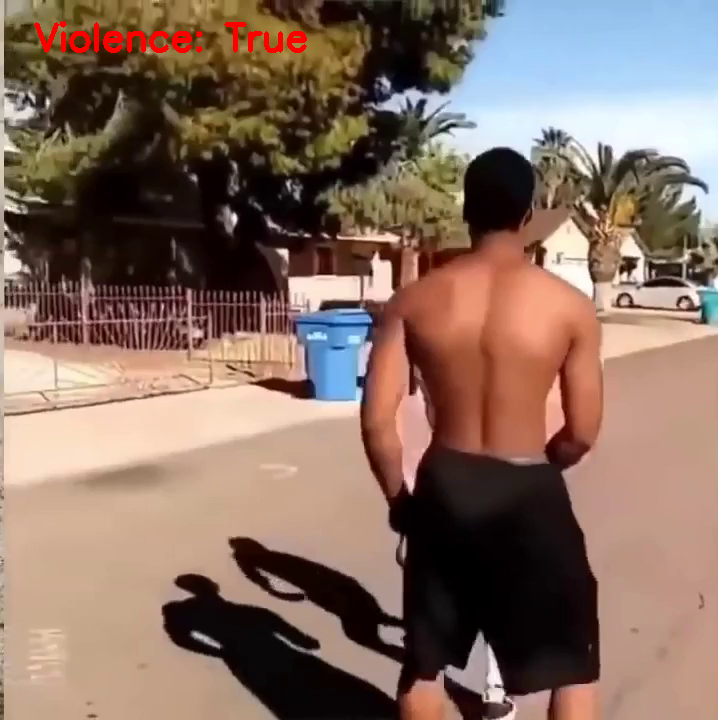

1/1 [==============================] - 0s 150ms/step


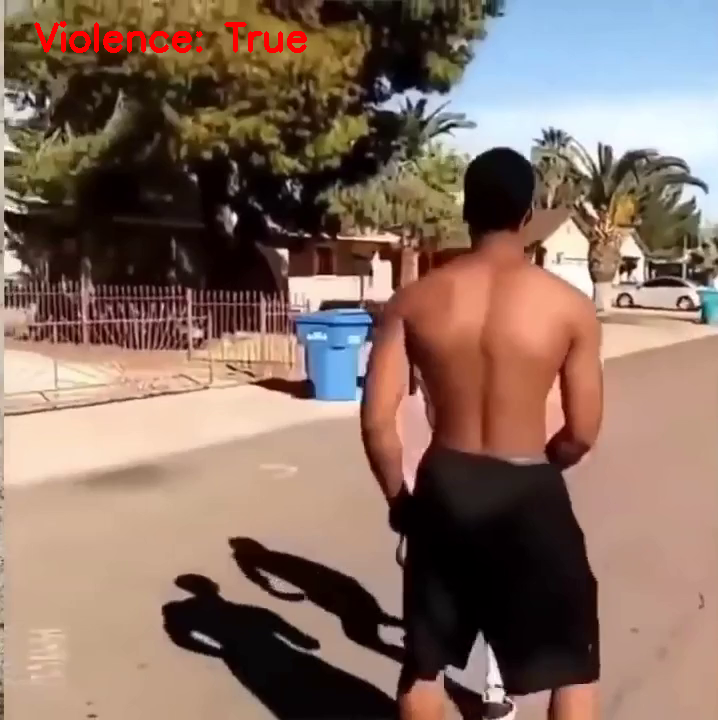

1/1 [==============================] - 0s 66ms/step


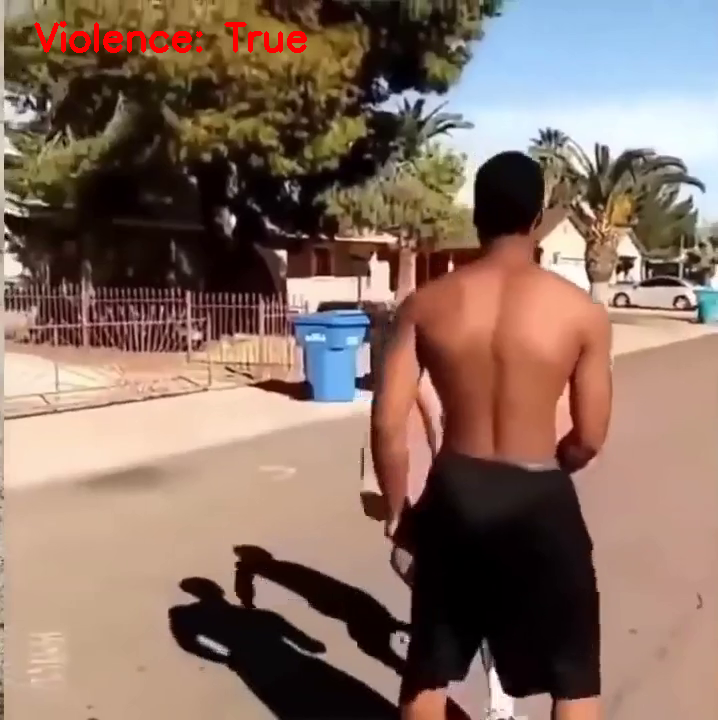

1/1 [==============================] - 0s 99ms/step


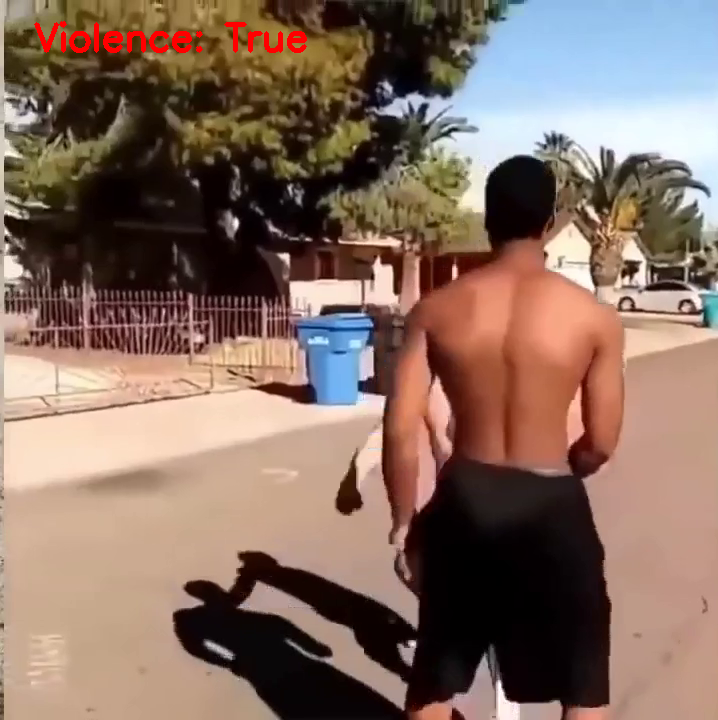

1/1 [==============================] - 0s 131ms/step


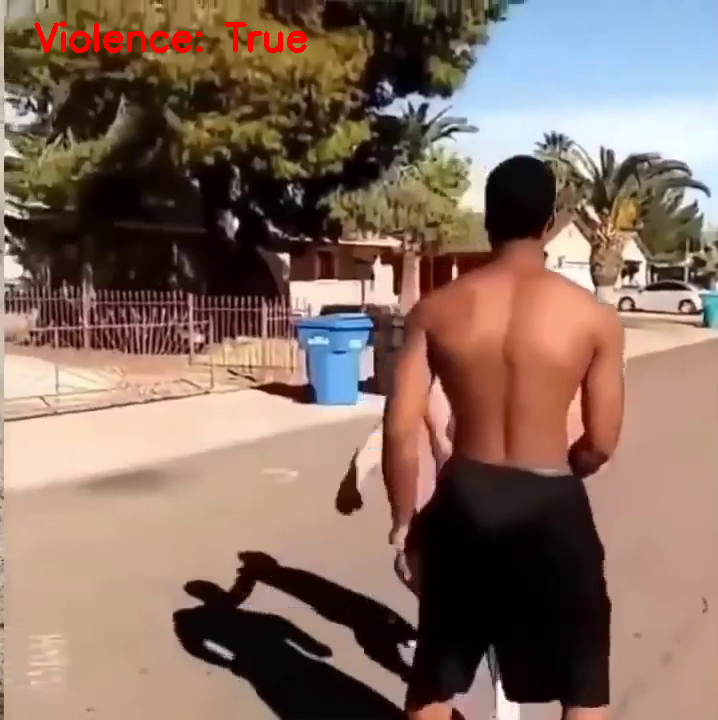

1/1 [==============================] - 0s 149ms/step


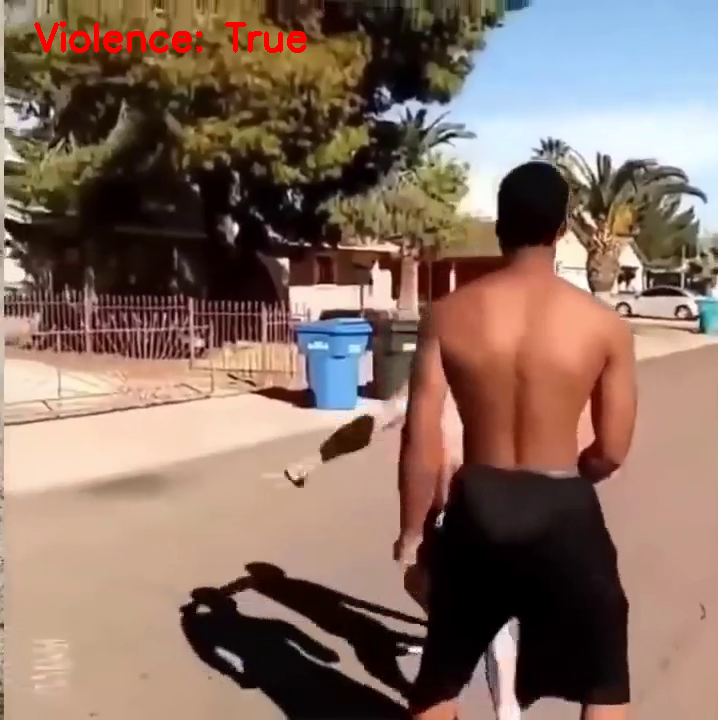

1/1 [==============================] - 0s 91ms/step


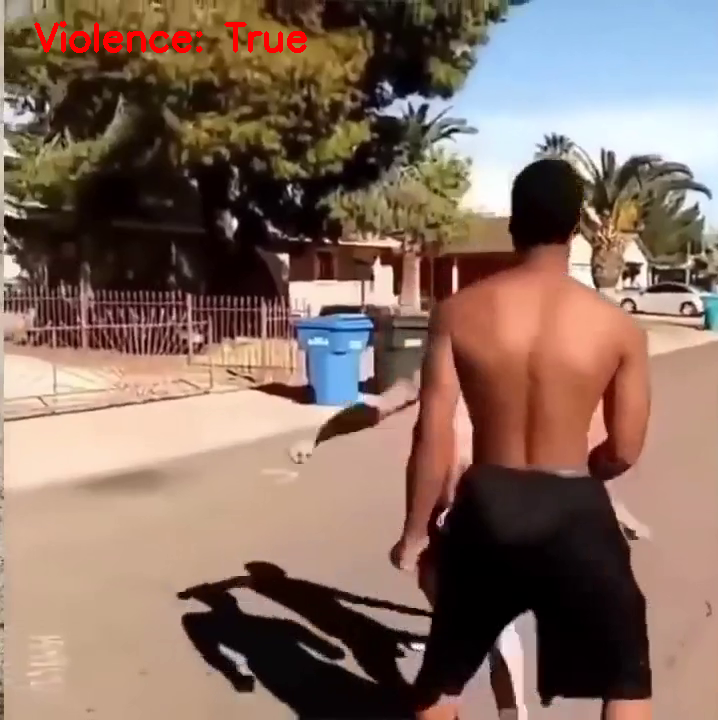

1/1 [==============================] - 0s 58ms/step


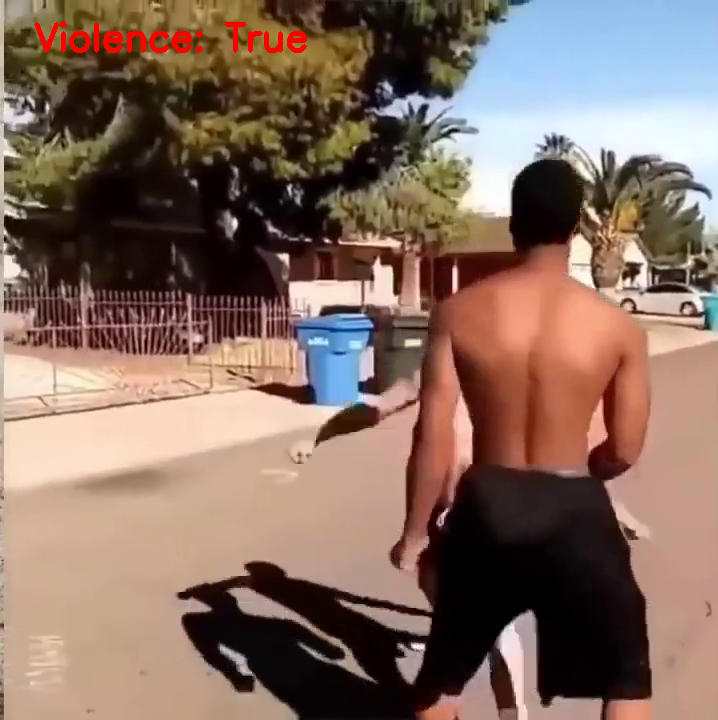

1/1 [==============================] - 0s 84ms/step


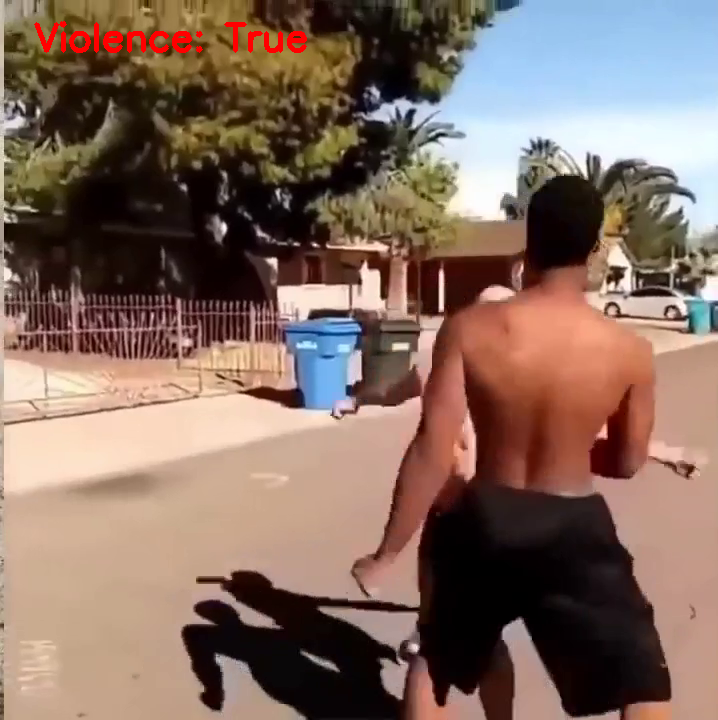

1/1 [==============================] - 0s 166ms/step


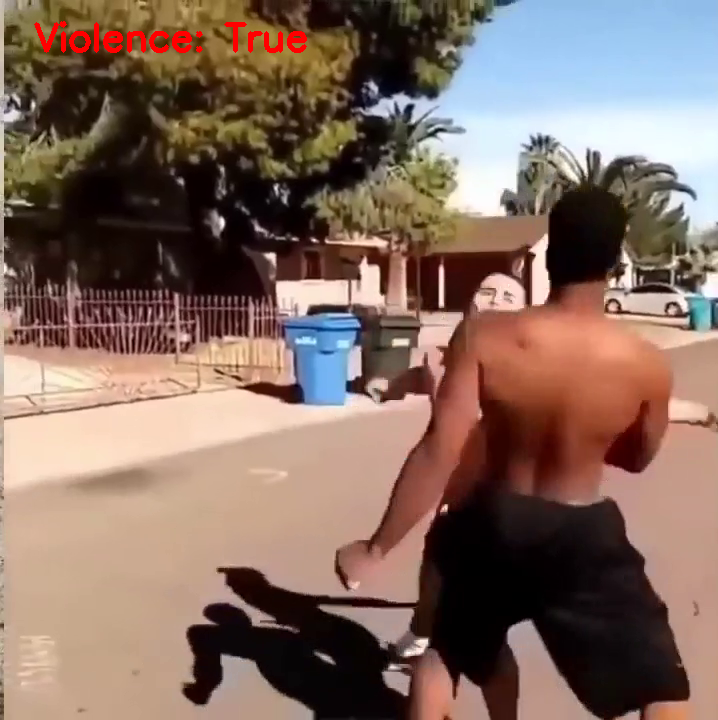

1/1 [==============================] - 0s 82ms/step


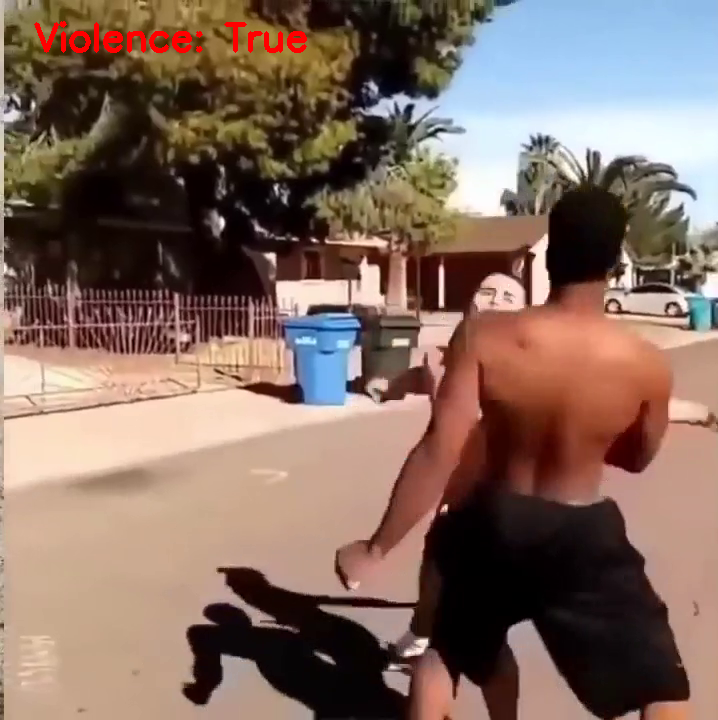

1/1 [==============================] - 0s 62ms/step


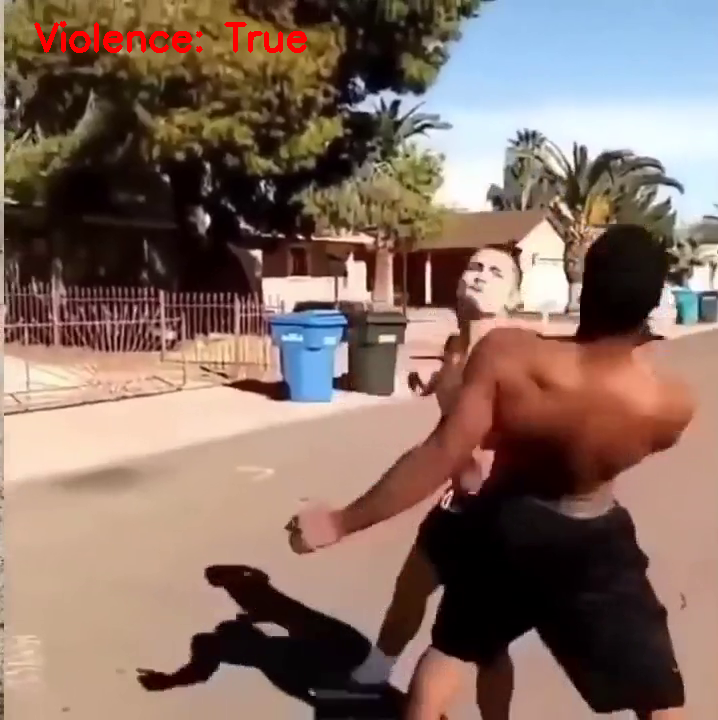

1/1 [==============================] - 0s 146ms/step


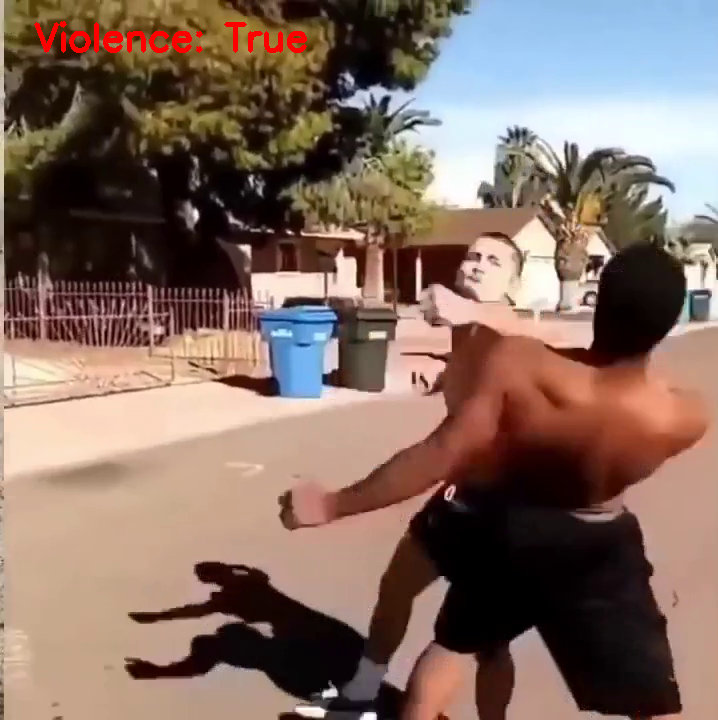

1/1 [==============================] - 0s 224ms/step


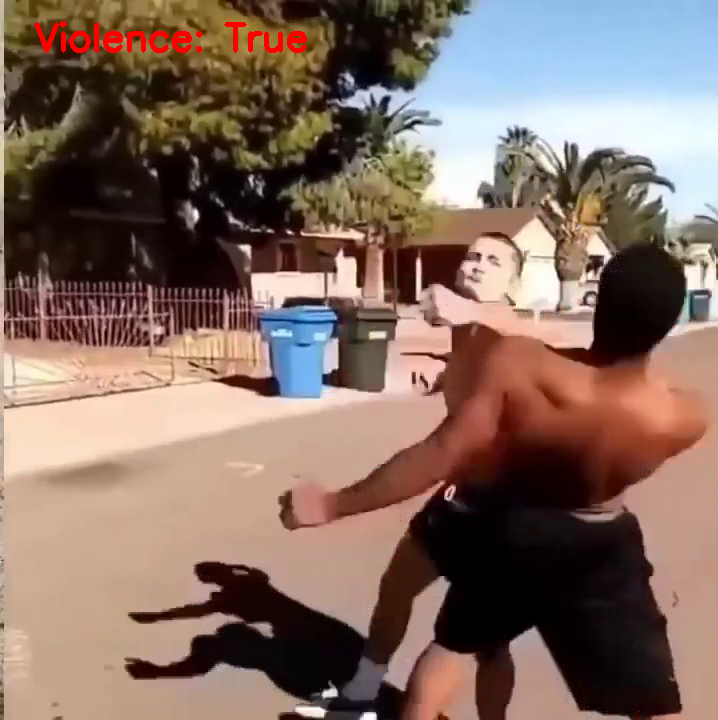

1/1 [==============================] - 0s 71ms/step


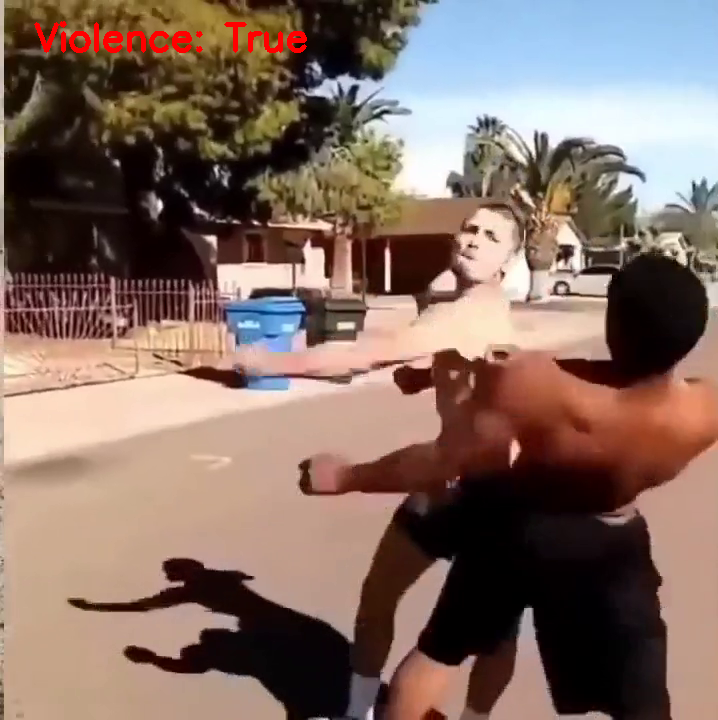

1/1 [==============================] - 0s 262ms/step


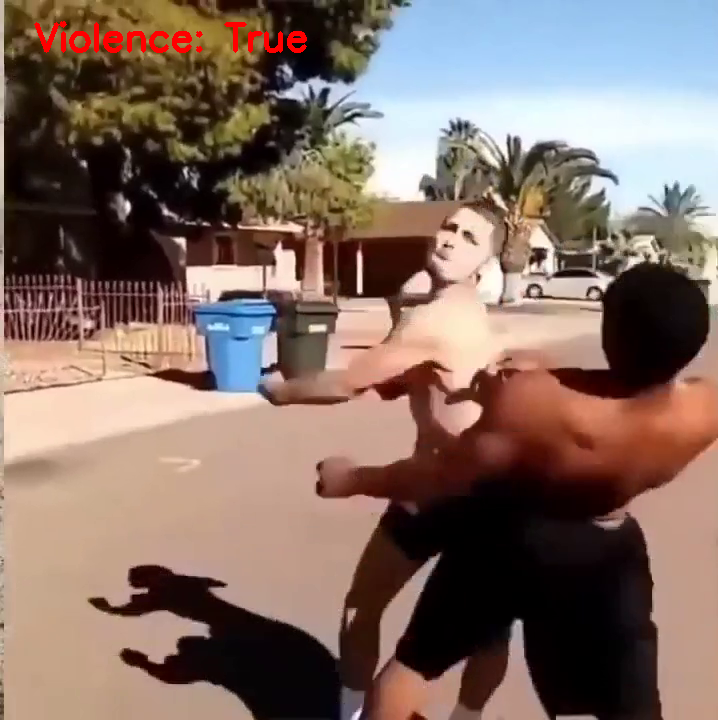

1/1 [==============================] - 0s 140ms/step


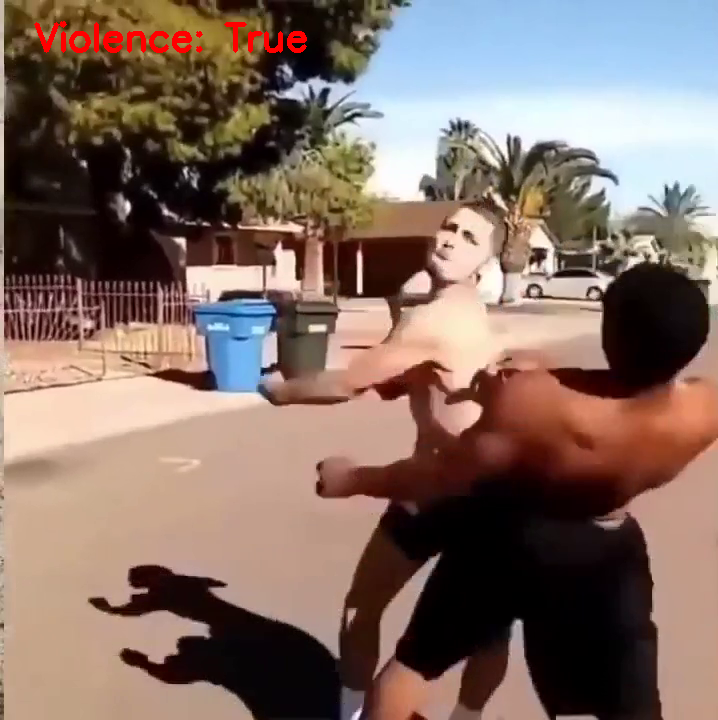

1/1 [==============================] - 0s 133ms/step


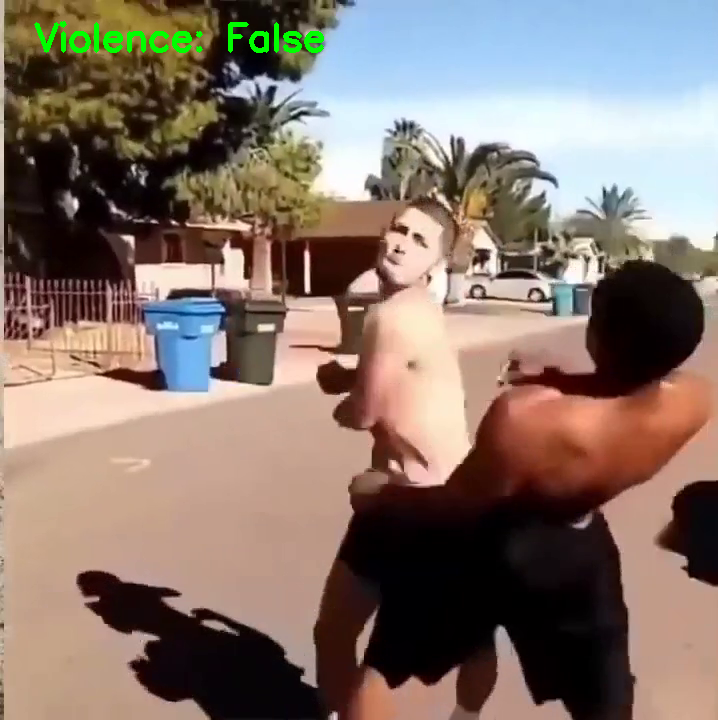

1/1 [==============================] - 0s 222ms/step


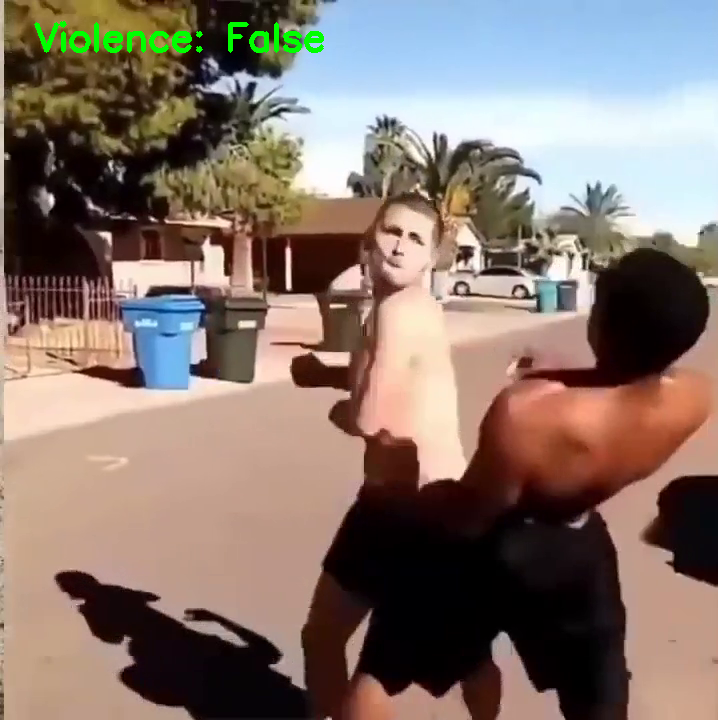

1/1 [==============================] - 0s 145ms/step


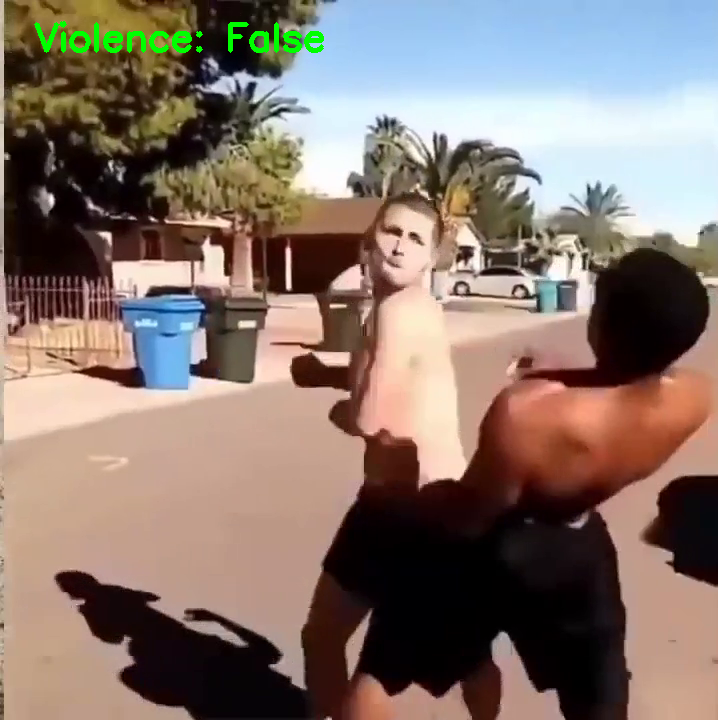

1/1 [==============================] - 0s 211ms/step


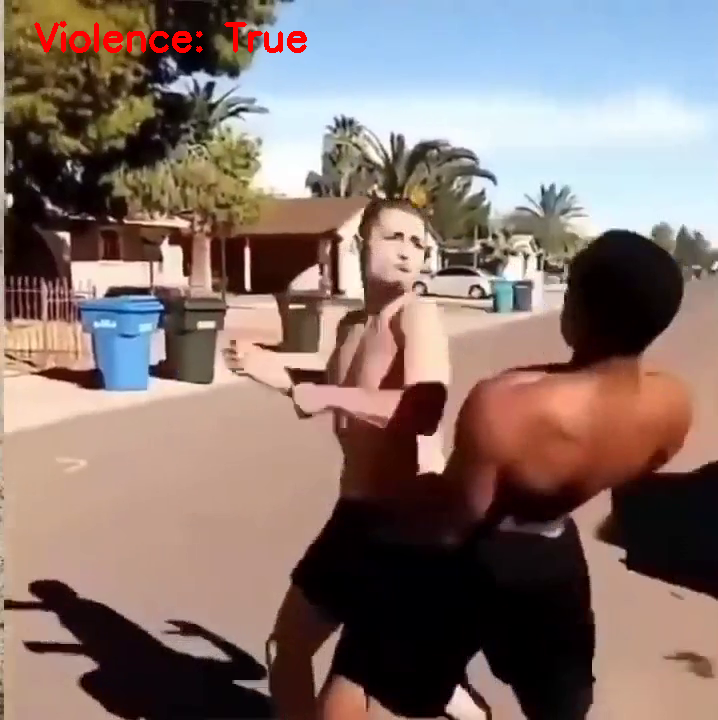

1/1 [==============================] - 0s 146ms/step


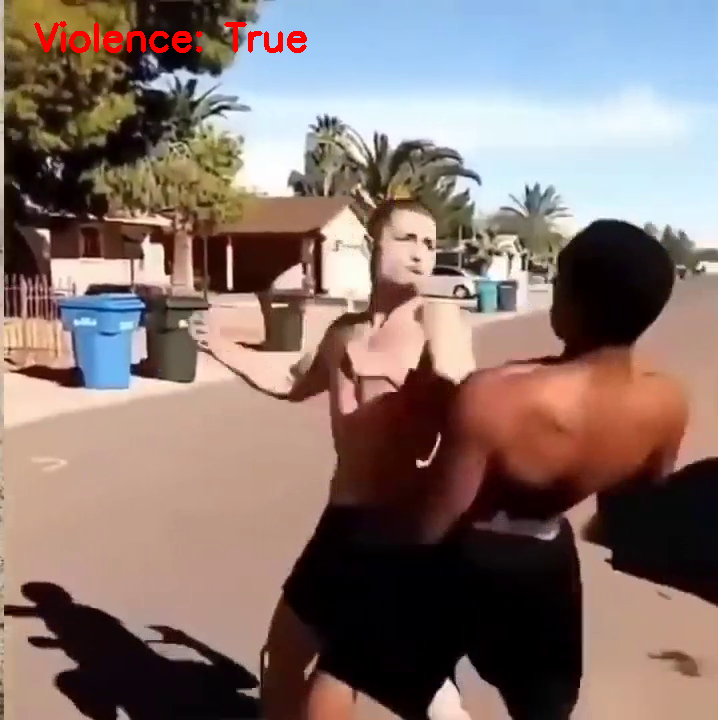

1/1 [==============================] - 0s 99ms/step


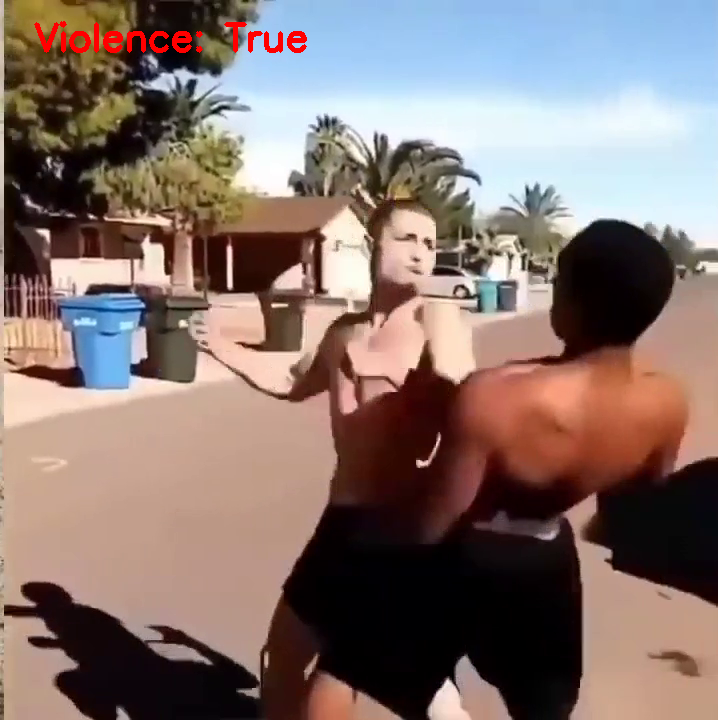

1/1 [==============================] - 0s 91ms/step


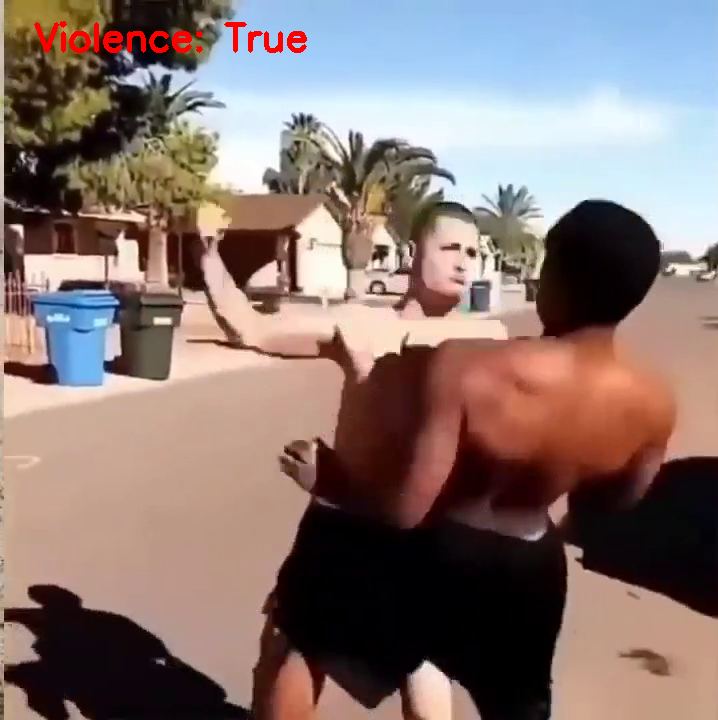

1/1 [==============================] - 0s 90ms/step


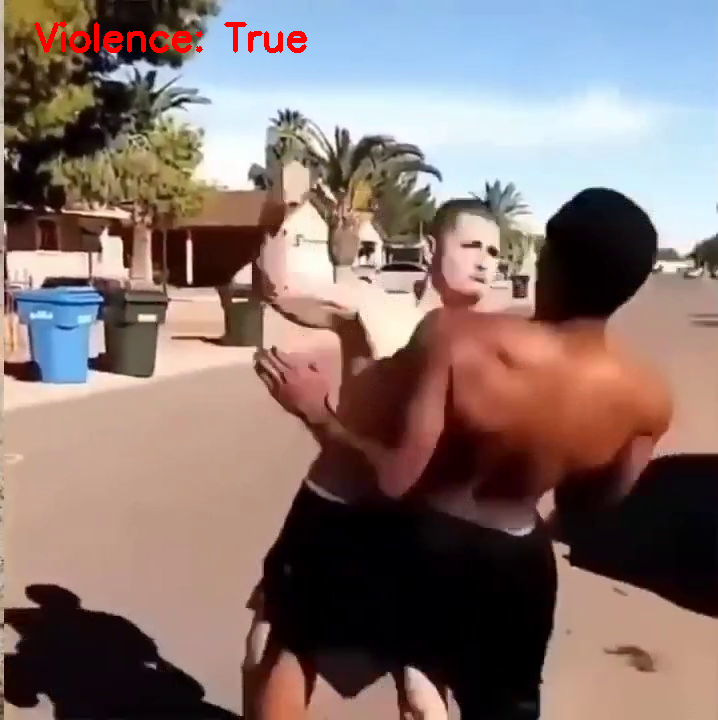

1/1 [==============================] - 0s 83ms/step


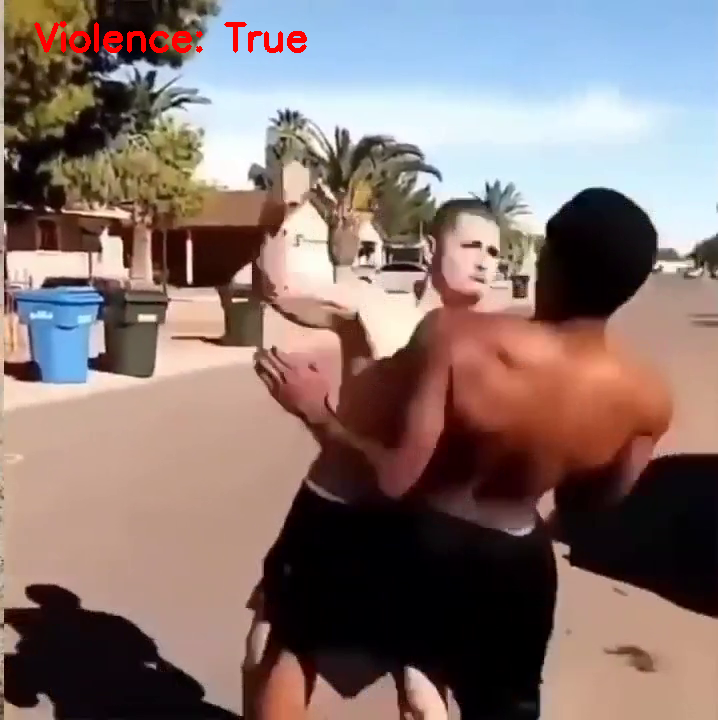

1/1 [==============================] - 0s 95ms/step


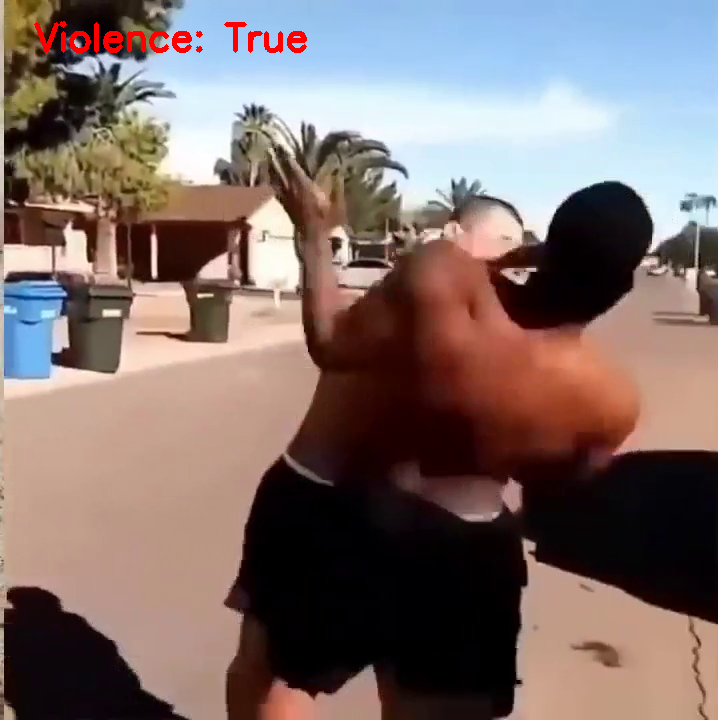

1/1 [==============================] - 0s 89ms/step


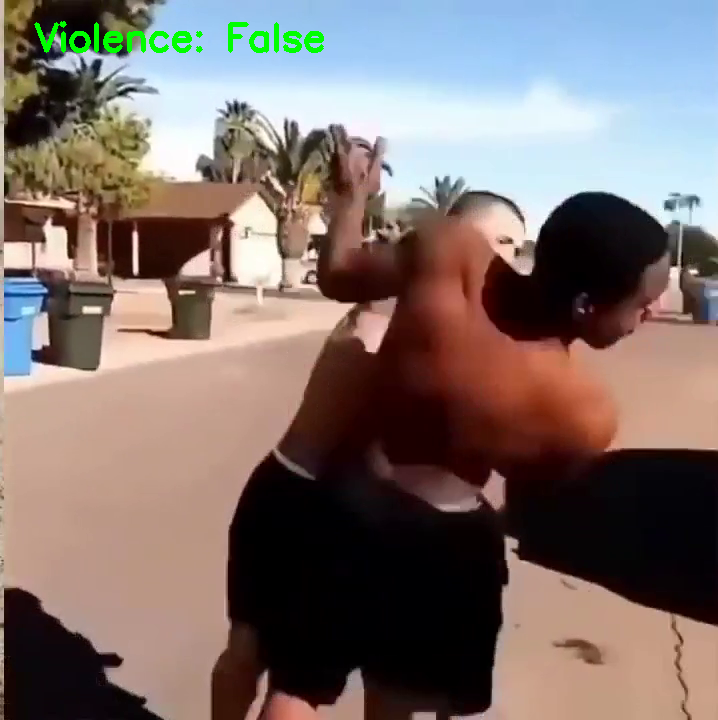

1/1 [==============================] - 0s 58ms/step


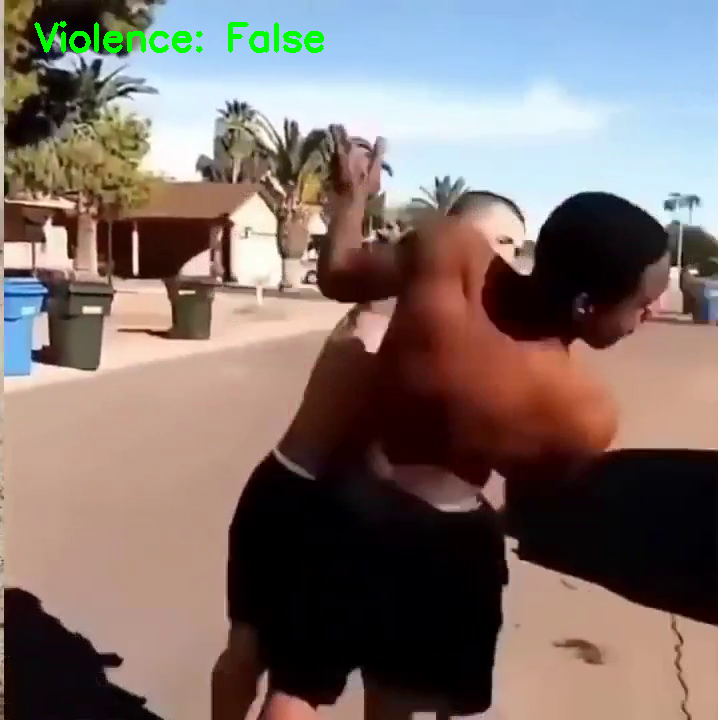

1/1 [==============================] - 0s 57ms/step


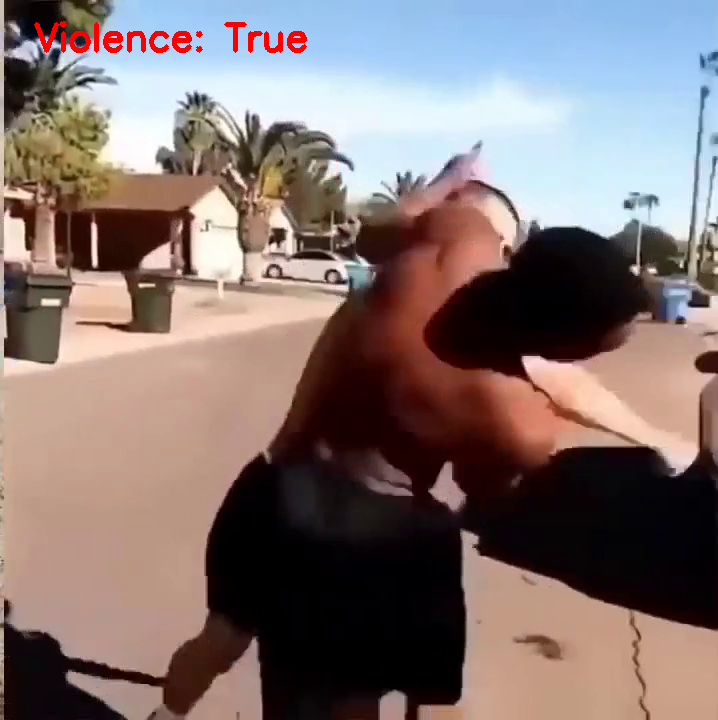

1/1 [==============================] - 0s 59ms/step


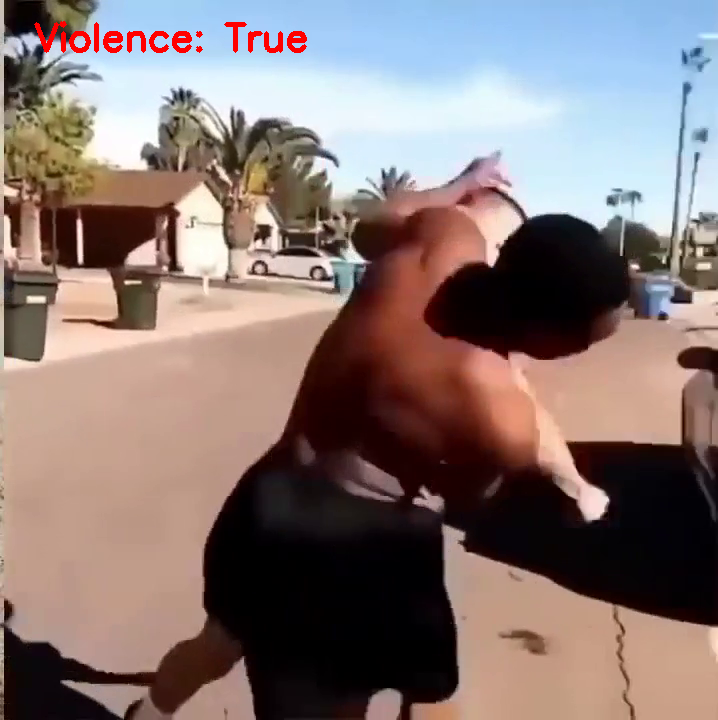

1/1 [==============================] - 0s 55ms/step


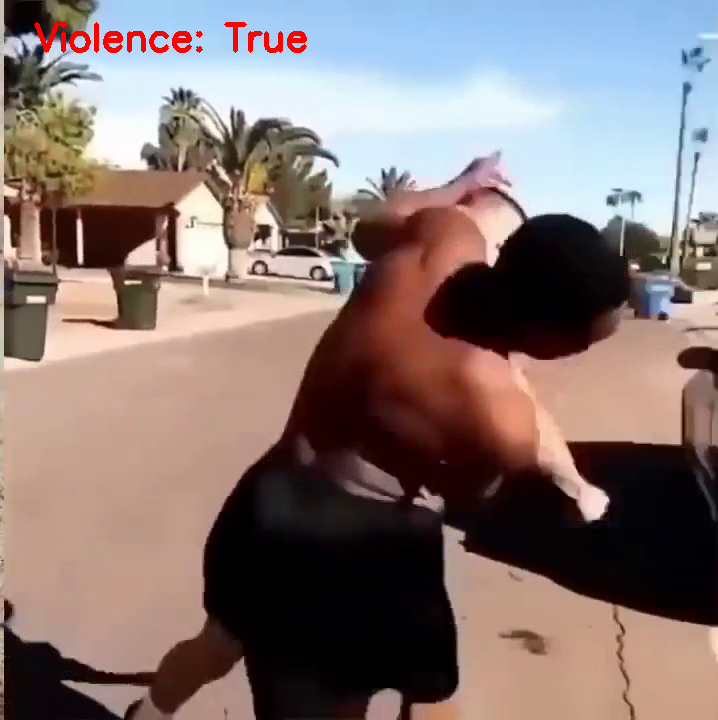

1/1 [==============================] - 0s 70ms/step


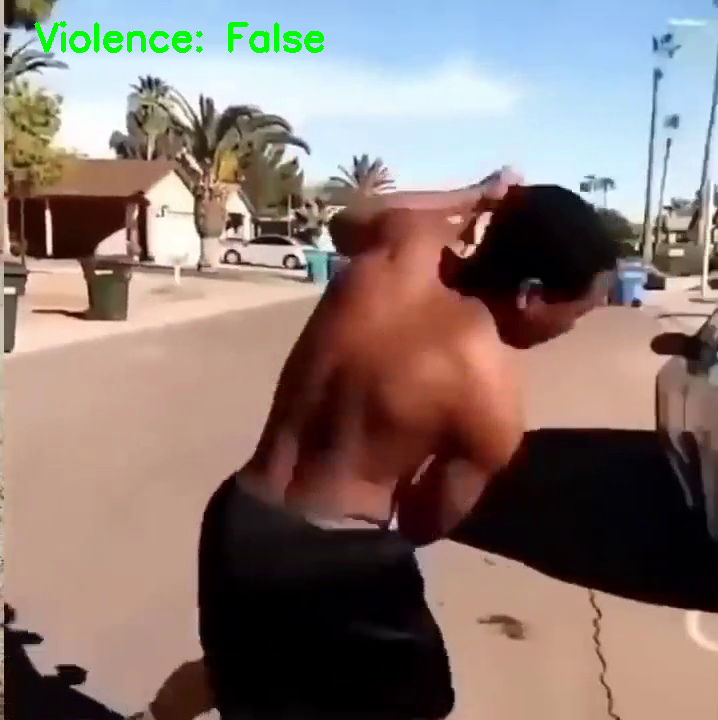

1/1 [==============================] - 0s 55ms/step


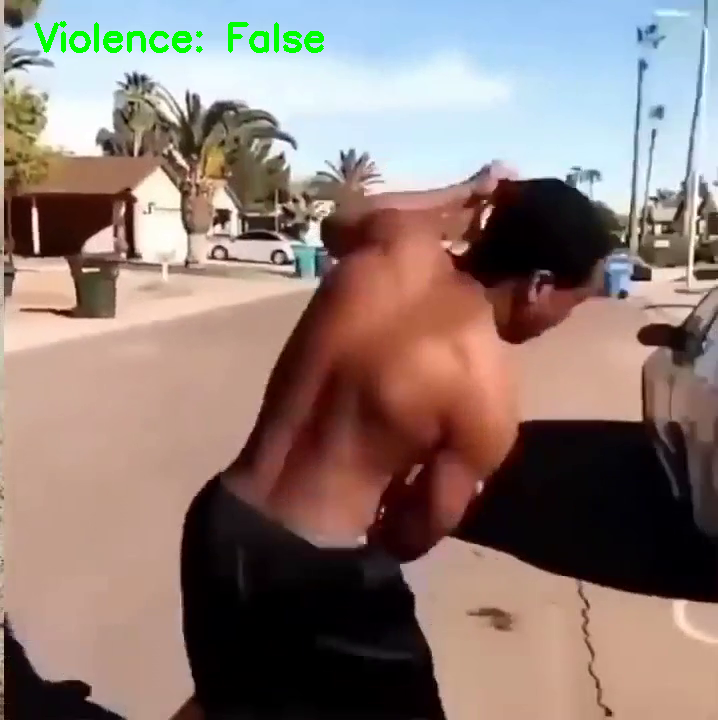

1/1 [==============================] - 0s 69ms/step


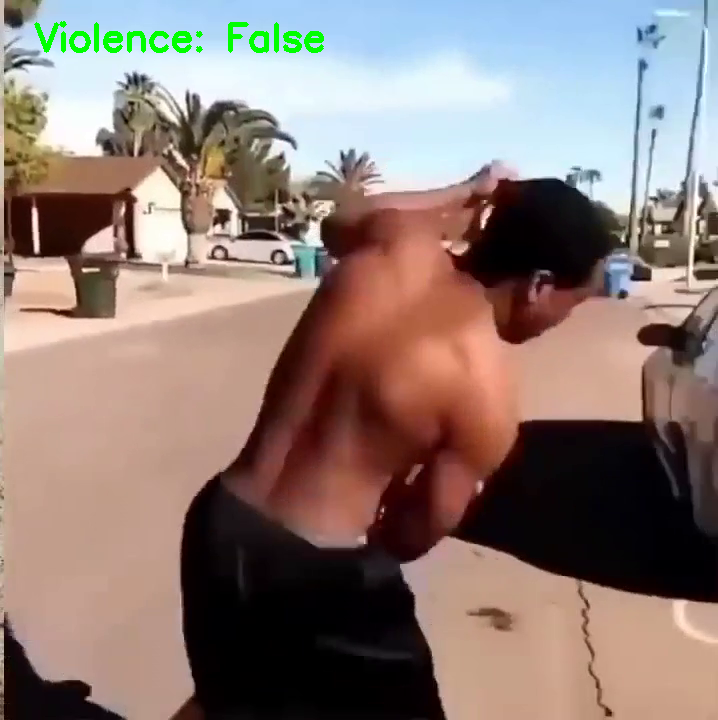

1/1 [==============================] - 0s 62ms/step


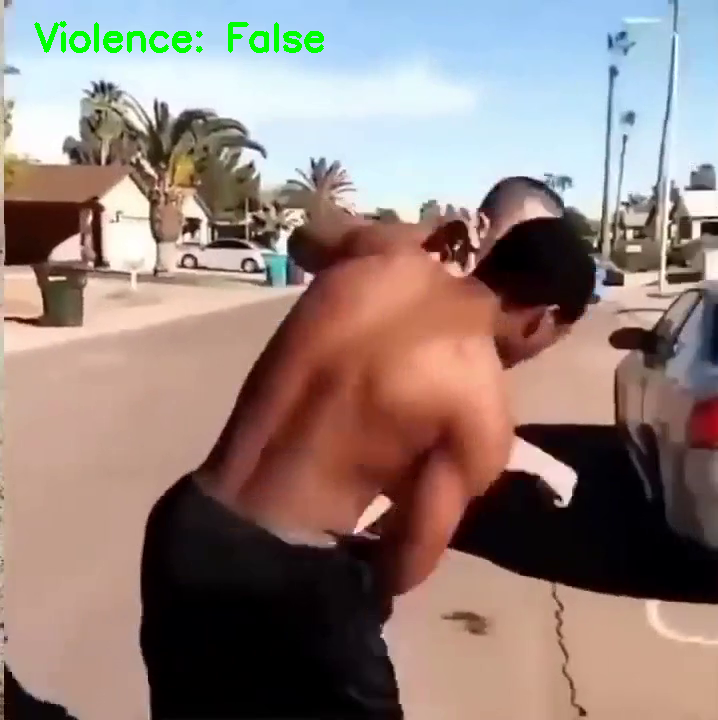

1/1 [==============================] - 0s 54ms/step


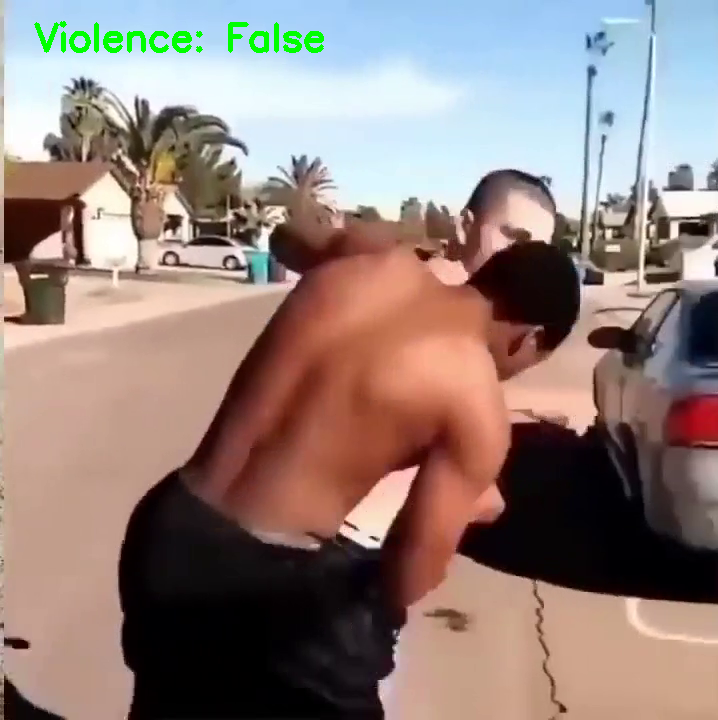

1/1 [==============================] - 0s 76ms/step


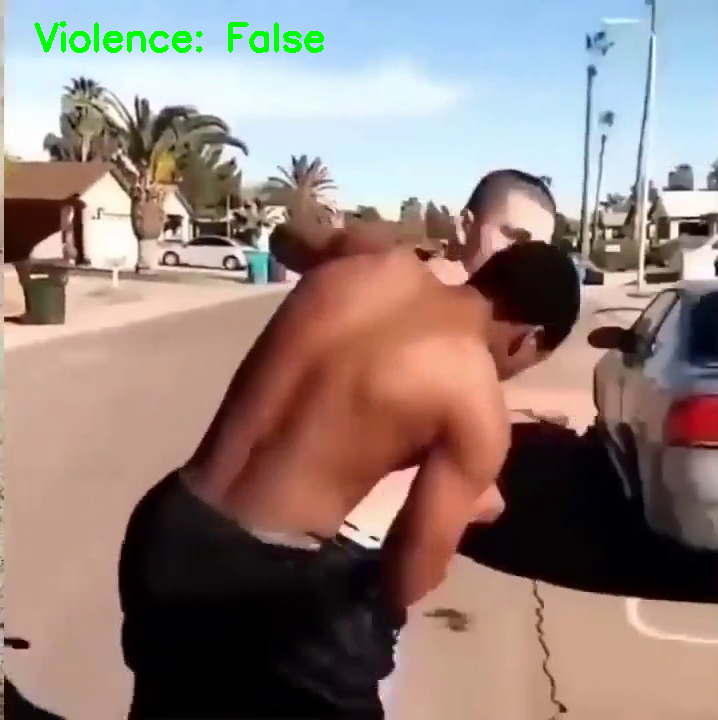

1/1 [==============================] - 0s 58ms/step


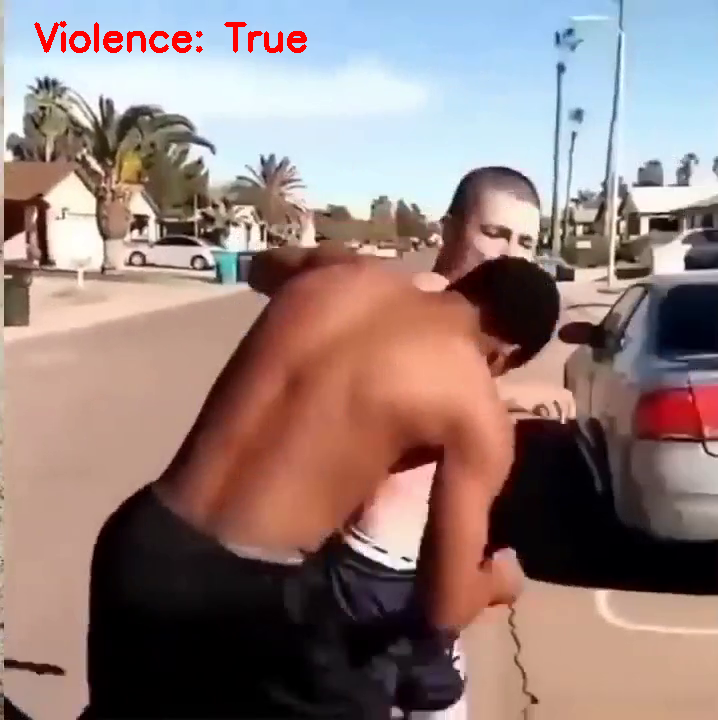

1/1 [==============================] - 0s 56ms/step


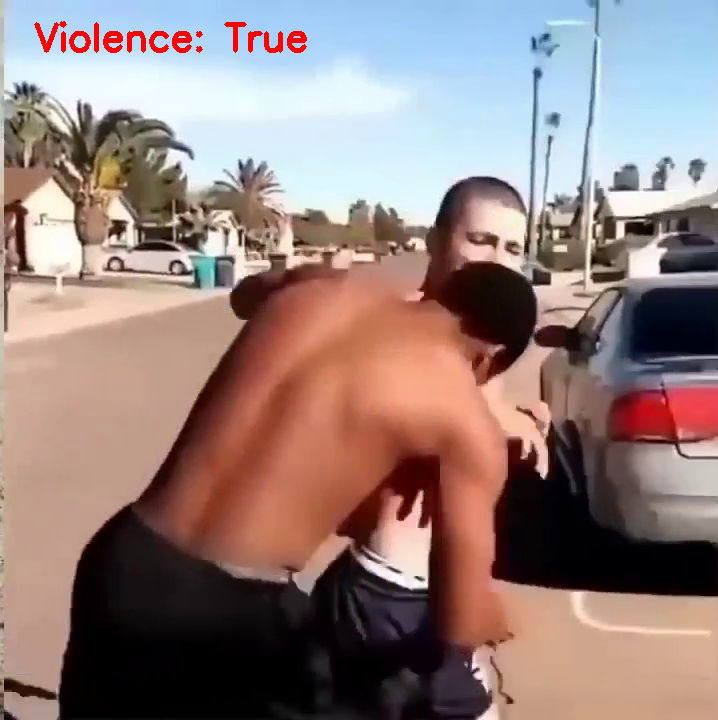

1/1 [==============================] - 0s 90ms/step


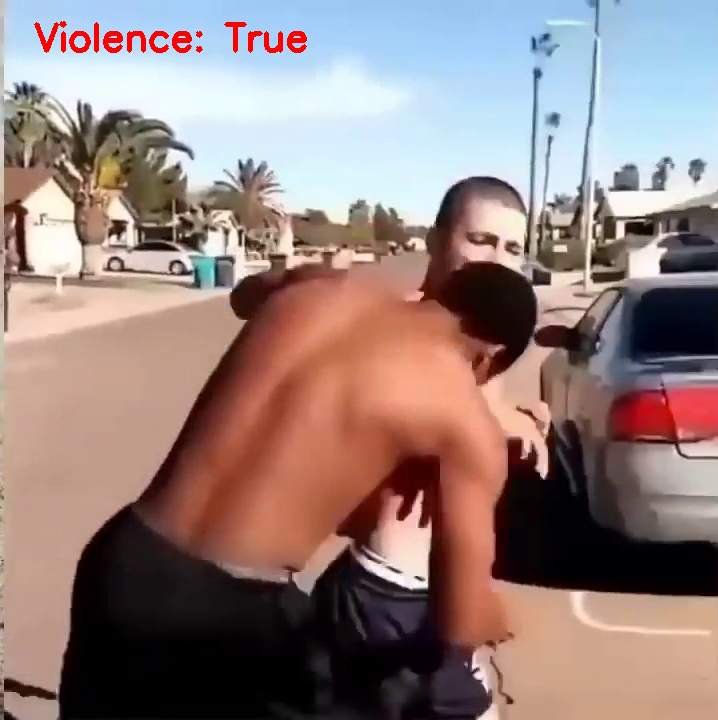

1/1 [==============================] - 0s 69ms/step


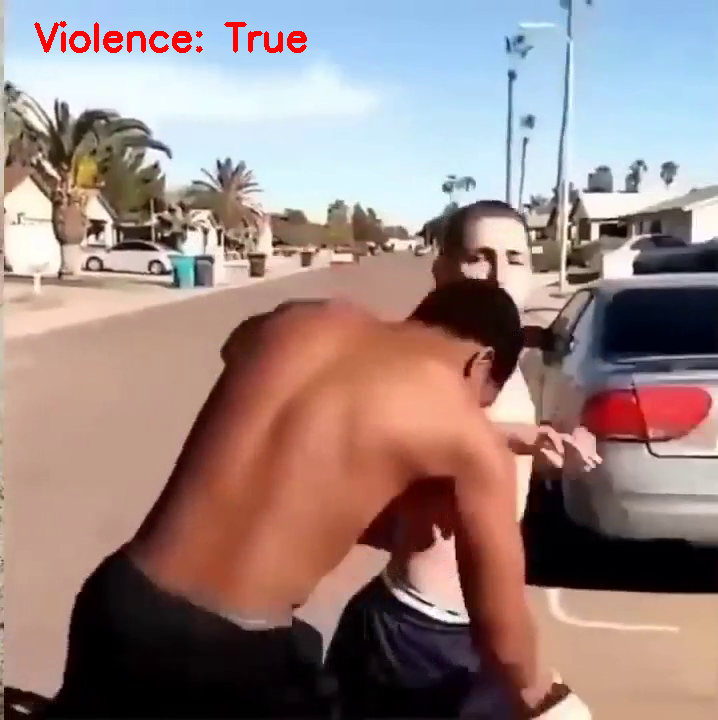

1/1 [==============================] - 0s 55ms/step


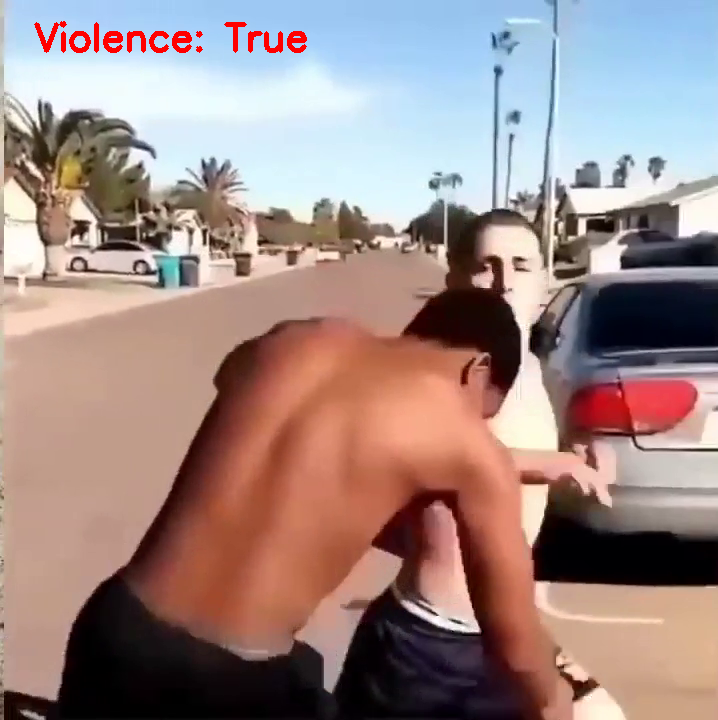

1/1 [==============================] - 0s 69ms/step


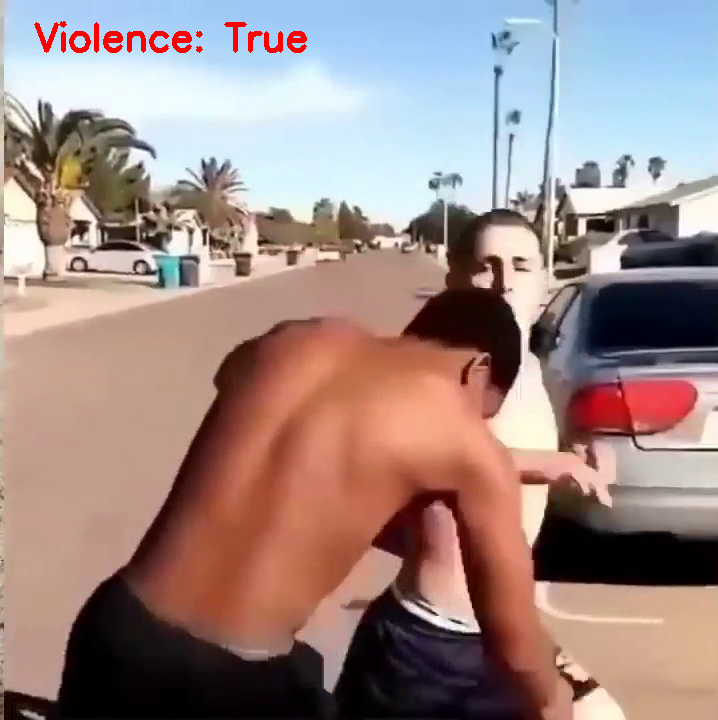

1/1 [==============================] - 0s 56ms/step


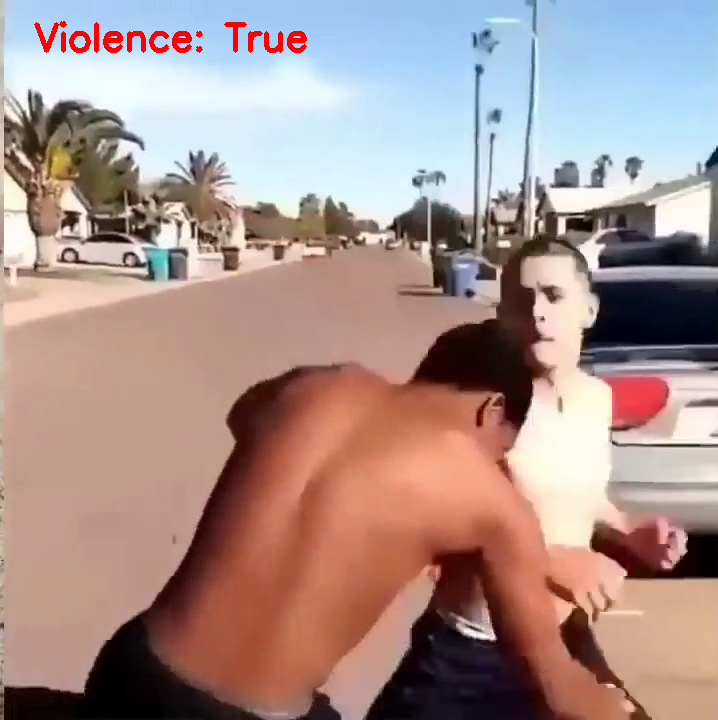

1/1 [==============================] - 0s 56ms/step


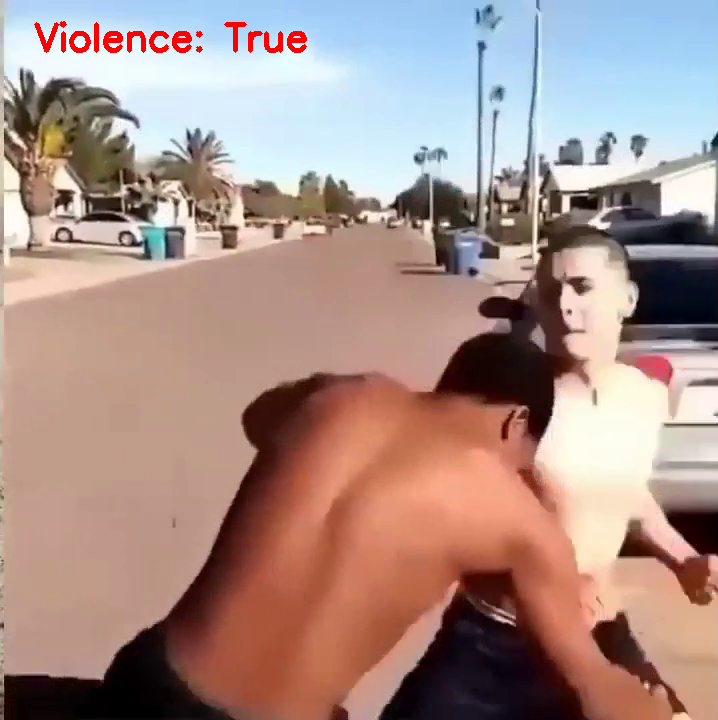

1/1 [==============================] - 0s 56ms/step


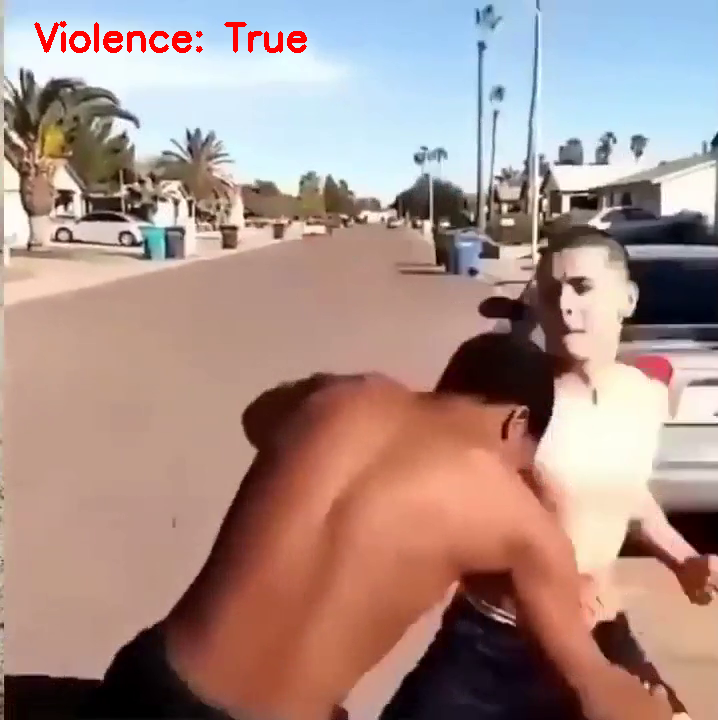

1/1 [==============================] - 0s 55ms/step


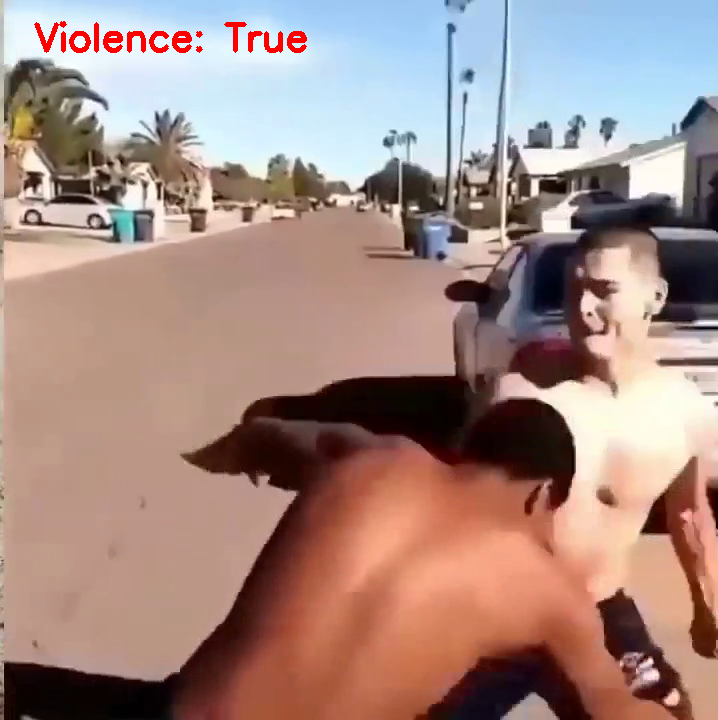

1/1 [==============================] - 0s 55ms/step


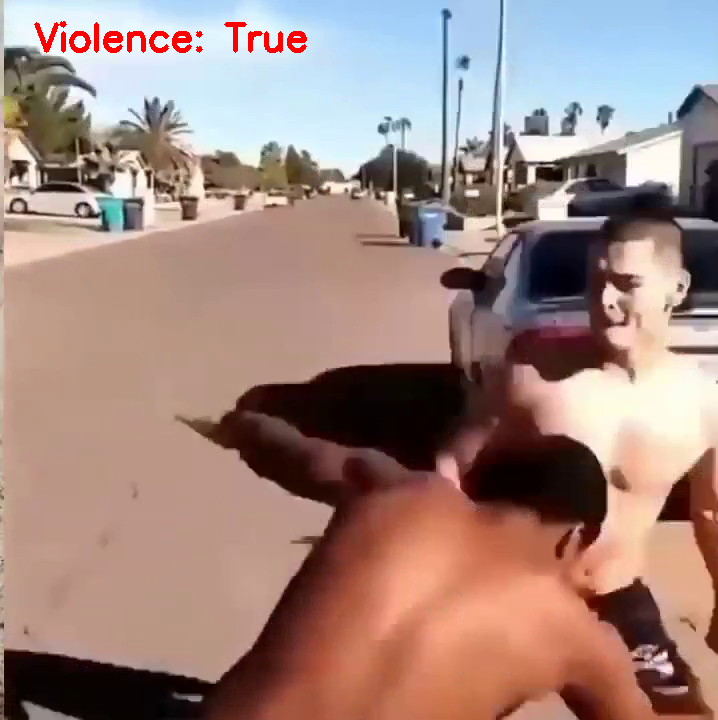

1/1 [==============================] - 0s 81ms/step


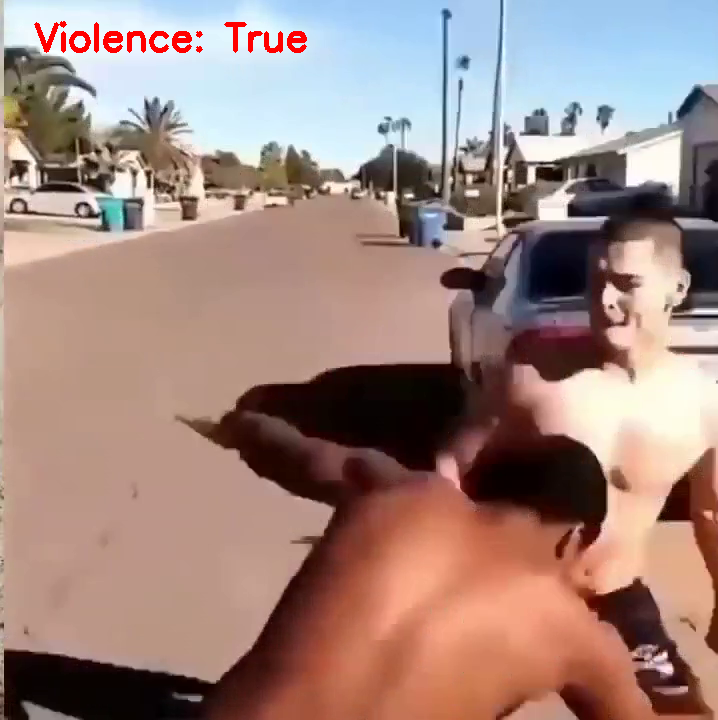

1/1 [==============================] - 0s 54ms/step


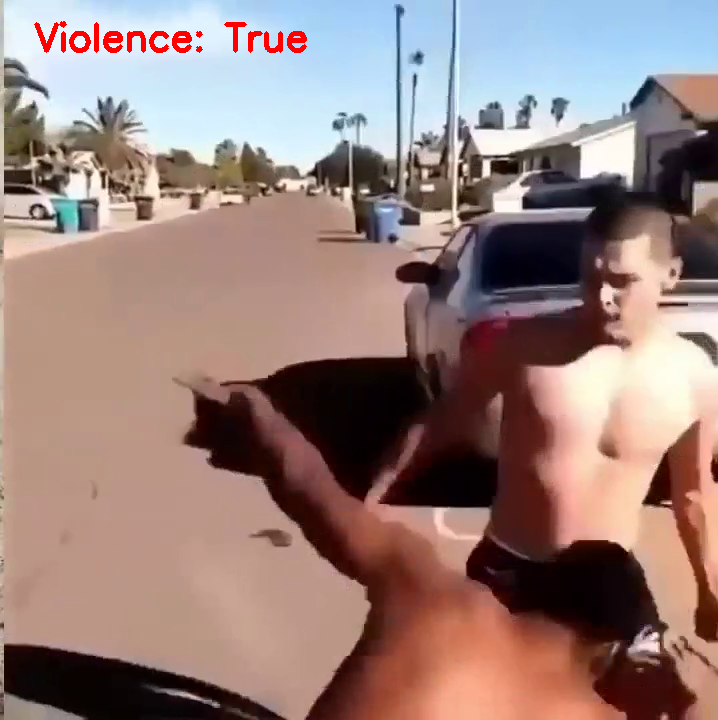

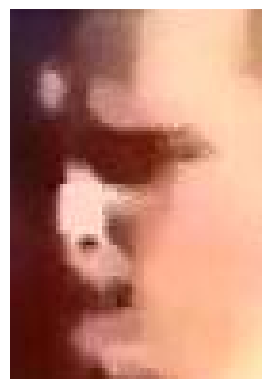

NameError: name 'storage' is not defined

In [ ]:
detectViolence(V_path)